# Counting the number of gluing problems for R(K4,K6-e)

## Order 16 case

First, we count the number of pointed graphs and save them.

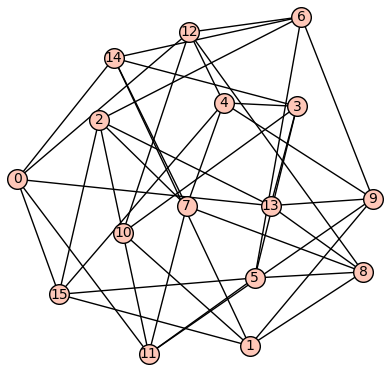

0 0 [11, 12, 13, 14, 15]
0 1 [8, 9, 10, 14, 15]
0 2 [6, 7, 10, 13, 15]
0 3 [4, 5, 10, 13, 14]
0 4 [3, 7, 9, 12, 15]
0 5 [3, 6, 8, 11, 15]
0 6 [2, 5, 9, 12, 14]
0 7 [2, 4, 8, 11, 14]
0 8 [1, 5, 7, 12, 13]
0 9 [1, 4, 6, 11, 13]
0 10 [1, 2, 3, 11, 12]
0 11 [0, 5, 7, 9, 10]
0 12 [0, 4, 6, 8, 10]
0 13 [0, 2, 3, 8, 9]
0 14 [0, 1, 3, 6, 7]
0 15 [0, 1, 2, 4, 5]


In [2]:
import itertools

pointed_graphs_5_ind = []

from sage.graphs.graph_input import from_graph6
with open('dataset_k3kme/k3k6e_16.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        G.show()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 5 and G.is_independent_set(possible_K):
                pointed_graphs_5_ind.append([G.copy(), vertex, possible_K])
                print(i,vertex, possible_K)

In [3]:
num_pointed_5 = len(pointed_graphs_5_ind)
num_pointed_5

16

There are 16 pointed graphs here. We now start counting the number of gluing problems.

In [4]:
num_pointed_5 * (num_pointed_5 + 1) / 2 * 120

16320

In [7]:
unique_gluings_5 = []

for i in range(num_pointed_5):
    pointed_graph = pointed_graphs_5_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(5):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_5):
        other_pointed_graph = pointed_graphs_5_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(5):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_5:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_5.append(H)
                #print("Unique")

print("Done")

Done


In [6]:
len(unique_gluings_5)

1

So there is only one gluing problem we need to consider.

## Order 15 Case

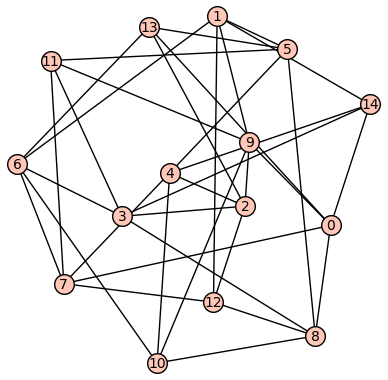

0 0 [7, 8, 9, 13, 14]
0 1 [5, 6, 9, 12, 14]
0 2 [3, 4, 9, 12, 13]
0 3 [2, 6, 8, 11, 14]
0 4 [2, 5, 7, 10, 14]
0 5 [1, 4, 8, 11, 13]
0 6 [1, 3, 7, 10, 13]
0 7 [0, 4, 6, 11, 12]
0 8 [0, 3, 5, 10, 12]
0 9 [0, 1, 2, 10, 11]
0 10 [4, 6, 8, 9]
0 11 [3, 5, 7, 9]
0 12 [1, 2, 7, 8]
0 13 [0, 2, 5, 6]
0 14 [0, 1, 3, 4]


In [8]:
import itertools

pointed_graphs_5_ind = []
pointed_graphs_4_ind = []

from sage.graphs.graph_input import from_graph6
with open('dataset_k3kme/k3k6e_15.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        G.show()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 4 and G.is_independent_set(possible_K):
                pointed_graphs_4_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 5 and G.is_independent_set(possible_K):
                pointed_graphs_5_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)

In [9]:
num_pointed_5 = len(pointed_graphs_5_ind)
num_pointed_4 = len(pointed_graphs_4_ind)
print(num_pointed_5 + num_pointed_4)

15


There are 15 pointed graphs here. We now start counting the number of gluing problems.

In [10]:
total_gluings = 0
total_gluings += num_pointed_5 * (num_pointed_5 + 1) / 2 * 120
total_gluings += num_pointed_4 * (num_pointed_4 + 1) / 2 * 24
total_gluings

6960

We now check these gluing problems for isomorphisms in order to eliminate any duplicate problems. To do so we split them into two cases based on the size of the intersection.

In [11]:
unique_gluings_5 = []

for i in range(num_pointed_5):
    pointed_graph = pointed_graphs_5_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(5):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_5):
        other_pointed_graph = pointed_graphs_5_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(5):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_5:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_5.append(H)
                #print("Unique")
                
print("Done")

Done


In [12]:
unique_gluings_4 = []

for i in range(num_pointed_4):
    pointed_graph = pointed_graphs_4_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(4):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_4):
        other_pointed_graph = pointed_graphs_4_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(4):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_4:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_4.append(H)
                #print("Unique")
                
print("Done")

Done


In [13]:
len(unique_gluings_5 + unique_gluings_4)

4

So we only need to consider 4 unique gluing problems.

## Order 14 Case

In [14]:
pointed_graphs_5_ind = []
pointed_graphs_4_ind = []
pointed_graphs_3_ind = []

from sage.graphs.graph_input import from_graph6
with open('dataset_k3kme/k3k6e_14.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 3 and G.is_independent_set(possible_K):
                pointed_graphs_3_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 4 and G.is_independent_set(possible_K):
                pointed_graphs_4_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 5 and G.is_independent_set(possible_K):
                pointed_graphs_5_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)

0 0 [3, 7, 9, 10, 11]
0 1 [2, 6, 8, 10, 11]
0 2 [1, 4, 5, 7, 9]
0 3 [0, 4, 5, 6, 8]
0 4 [2, 3, 11, 13]
0 5 [2, 3, 10, 12]
0 6 [1, 3, 9, 12]
0 7 [0, 2, 8, 12]
0 8 [1, 3, 7, 13]
0 9 [0, 2, 6, 13]
0 10 [0, 1, 5, 13]
0 11 [0, 1, 4, 12]
0 12 [5, 6, 7, 11]
0 13 [4, 8, 9, 10]
1 0 [4, 5, 7, 12, 13]
1 1 [2, 3, 6, 12, 13]
1 2 [1, 5, 7, 10, 11]
1 3 [1, 4, 7, 8, 9]
1 4 [0, 3, 6, 10, 11]
1 5 [0, 2, 6, 8, 9]
1 6 [1, 4, 5, 7]
1 7 [0, 2, 3, 6]
1 8 [3, 5, 11, 13]
1 9 [3, 5, 10, 12]
1 10 [2, 4, 9, 13]
1 11 [2, 4, 8, 12]
1 12 [0, 1, 9, 11]
1 13 [0, 1, 8, 10]
2 0 [4, 5, 10, 11, 13]
2 1 [2, 3, 10, 11, 12]
2 2 [1, 5, 8, 9, 13]
2 3 [1, 4, 6, 7, 13]
2 4 [0, 3, 8, 9, 12]
2 5 [0, 2, 6, 7, 12]
2 6 [3, 5, 9, 11]
2 7 [3, 5, 8, 10]
2 8 [2, 4, 7, 11]
2 9 [2, 4, 6, 10]
2 10 [0, 1, 7, 9]
2 11 [0, 1, 6, 8]
2 12 [1, 4, 5]
2 13 [0, 2, 3]
3 0 [5, 10, 11, 12, 13]
3 1 [4, 8, 9, 12, 13]
3 2 [3, 7, 9, 11, 13]
3 3 [2, 6, 8, 10, 12]
3 4 [1, 6, 7, 10, 11]
3 5 [0, 6, 7, 8, 9]
3 6 [3, 4, 5, 13]
3 7 [2, 4, 5, 12]
3 8 [1, 3, 5, 11]


In [15]:
num_pointed_5 = len(pointed_graphs_5_ind)
num_pointed_4 = len(pointed_graphs_4_ind)
num_pointed_3 = len(pointed_graphs_3_ind)
print(num_pointed_5 + num_pointed_4 + num_pointed_3)

56


There are 56 pointed graphs for 14 vertices. We now start counting the total number of gluing problems before checking for isomorphisms.

In [16]:
total_gluings = 0
total_gluings += num_pointed_5 * (num_pointed_5 + 1) / 2 * 120
total_gluings += num_pointed_4 * (num_pointed_4 + 1) / 2 * 24
total_gluings += num_pointed_3 * (num_pointed_3 + 1) / 2 * 6
total_gluings

43050

In [17]:
unique_gluings_5 = []

for i in range(num_pointed_5):
    pointed_graph = pointed_graphs_5_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(5):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_5):
        other_pointed_graph = pointed_graphs_5_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(5):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_5:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_5.append(H)
               #print("Unique")
            
print("Done")

Done


In [18]:
unique_gluings_4 = []

for i in range(num_pointed_4):
    pointed_graph = pointed_graphs_4_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(4):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_4):
        other_pointed_graph = pointed_graphs_4_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(4):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_4:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_4.append(H)
                #print("Unique")
            
print("Done")

Done


In [19]:
unique_gluings_3 = []

for i in range(num_pointed_3):
    pointed_graph = pointed_graphs_3_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(3):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_3):
        other_pointed_graph = pointed_graphs_3_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(3):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_3:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_3.append(H)
                #print("Unique")
            
print("Done")

Done


In [20]:
len(unique_gluings_5 + unique_gluings_4 + unique_gluings_3)

133

So we only need to consider 133 gluings for this case.

## Order 13 Case

In [21]:
pointed_graphs_5_ind = []
pointed_graphs_4_ind = []
pointed_graphs_3_ind = []
pointed_graphs_2_ind = []

from sage.graphs.graph_input import from_graph6
with open('dataset_k3kme/k3k6e_13.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 2 and G.is_independent_set(possible_K):
                pointed_graphs_2_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 3 and G.is_independent_set(possible_K):
                pointed_graphs_3_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 4 and G.is_independent_set(possible_K):
                pointed_graphs_4_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 5 and G.is_independent_set(possible_K):
                pointed_graphs_5_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)


0 0 [1, 2, 9, 11, 12]
0 1 [0, 5, 6, 8, 10]
0 2 [0, 3, 4, 7, 10]
0 3 [2, 6, 8, 12]
0 4 [2, 5, 8, 11]
0 5 [1, 4, 7, 12]
0 6 [1, 3, 7, 11]
0 7 [2, 5, 6, 9]
0 8 [1, 3, 4, 9]
0 9 [0, 7, 8, 10]
0 10 [1, 2, 9]
0 11 [0, 4, 6]
0 12 [0, 3, 5]
1 0 [1, 2, 9, 10, 11]
1 1 [0, 6, 7, 8, 12]
1 2 [0, 3, 4, 5, 12]
1 3 [2, 7, 8, 11]
1 4 [2, 6, 8, 10]
1 5 [2, 6, 7, 9]
1 6 [1, 4, 5, 11]
1 7 [1, 3, 5, 10]
1 8 [1, 3, 4, 9]
1 9 [0, 5, 8]
1 10 [0, 4, 7]
1 11 [0, 3, 6]
1 12 [1, 2]
2 0 [1, 3, 4, 9, 12]
2 1 [0, 2, 5, 10, 11]
2 2 [1, 7, 8, 12]
2 3 [0, 6, 8, 11]
2 4 [0, 7, 8, 10]
2 5 [1, 6, 8, 9]
2 6 [3, 5, 10, 12]
2 7 [2, 4, 9, 11]
2 8 [2, 3, 4, 5]
2 9 [0, 5, 7]
2 10 [1, 4, 6]
2 11 [1, 3, 7]
2 12 [0, 2, 6]
3 0 [1, 3, 5, 7, 12]
3 1 [0, 2, 4, 6, 11]
3 2 [1, 7, 9, 10]
3 3 [0, 6, 8, 10]
3 4 [1, 8, 10, 12]
3 5 [0, 9, 10, 11]
3 6 [1, 3, 7, 9]
3 7 [0, 2, 6, 8]
3 8 [3, 4, 7, 11]
3 9 [2, 5, 6, 12]
3 10 [2, 3, 4, 5]
3 11 [1, 5, 8]
3 12 [0, 4, 9]
4 0 [1, 3, 5, 8, 9]
4 1 [0, 2, 4, 6, 7]
4 2 [1, 9, 11, 12]
4 3 [0, 7, 10, 12]
4 

In [22]:
num_pointed_5 = len(pointed_graphs_5_ind)
num_pointed_4 = len(pointed_graphs_4_ind)
num_pointed_3 = len(pointed_graphs_3_ind)
num_pointed_2 = len(pointed_graphs_2_ind)
print(num_pointed_5 + num_pointed_4 + num_pointed_3 + num_pointed_2)

286


There are 286 graphs for 13 vertices. We now count the total number of gluings before eliminating any duplicates.

In [28]:
total_gluings = 0
total_gluings += num_pointed_5 * (num_pointed_5 + 1) / 2 * 120
total_gluings += num_pointed_4 * (num_pointed_4 + 1) / 2 * 24
total_gluings += num_pointed_3 * (num_pointed_3 + 1) / 2 * 6
total_gluings += num_pointed_2 * (num_pointed_3 + 1) / 2 * 2
print(num_pointed_5 * (num_pointed_5 + 1) / 2 * 120)
print(num_pointed_4 * (num_pointed_4 + 1) / 2 * 24)
print(num_pointed_3 * (num_pointed_3 + 1) / 2 * 6)
print(num_pointed_2 * (num_pointed_2 + 1) / 2 * 2)
total_gluings

118800
477600
5418
2


601861

In [24]:
unique_gluings_5 = []

for i in range(num_pointed_5):
    pointed_graph = pointed_graphs_5_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(5):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_5):
        other_pointed_graph = pointed_graphs_5_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(5):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_5:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_5.append(H)
                #print("Unique")
            
print("Done")

Done


In [11]:
unique_gluings_4 = []

for i in range(num_pointed_4):
    pointed_graph = pointed_graphs_4_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(4):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_4):
        other_pointed_graph = pointed_graphs_4_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(4):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_4:
                if H.is_isomorphic(gluing):
                    unique = false
                    print("NOT Unique")
            
            if unique:
                unique_gluings_4.append(H)
                print("Unique")

Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Uniqu

NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Uniq

Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Un

Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Uniq

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Uni

Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique


Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

In [25]:
unique_gluings_3 = []

for i in range(num_pointed_3):
    pointed_graph = pointed_graphs_3_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(3):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_3):
        other_pointed_graph = pointed_graphs_3_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(3):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_3:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_3.append(H)
                #print("Unique")
            
print("Done")

Done


In [26]:
unique_gluings_2 = []

for i in range(num_pointed_2):
    pointed_graph = pointed_graphs_2_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(2):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_2):
        other_pointed_graph = pointed_graphs_2_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(2):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_2:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_2.append(H)
                #print("Unique")
            
print("Done")

Done


In [29]:
len(unique_gluings_5)
len(unique_gluings_4)
len(unique_gluings_3)
len(unique_gluings_2)
len(unique_gluings_5 + unique_gluings_4 + unique_gluings_3 + unique_gluings_2)

6551

## Order 12 Case

In [30]:
import itertools

pointed_graphs_5_ind = []
pointed_graphs_4_ind = []
pointed_graphs_3_ind = []
pointed_graphs_2_ind = []
pointed_graphs_1_ind = []

from sage.graphs.graph_input import from_graph6
with open('dataset_k3kme/k3k6e_12.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 1 and G.is_independent_set(possible_K):
                pointed_graphs_1_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 2 and G.is_independent_set(possible_K):
                pointed_graphs_2_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 3 and G.is_independent_set(possible_K):
                pointed_graphs_3_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 4 and G.is_independent_set(possible_K):
                pointed_graphs_4_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)
            if len(possible_K) == 5 and G.is_independent_set(possible_K):
                pointed_graphs_5_ind.append([G.copy(), vertex, possible_K])
                print(i, vertex, possible_K)

0 0 [1, 2, 3, 4, 11]
0 1 [0, 6, 9, 10]
0 2 [0, 5, 6, 8]
0 3 [0, 5, 6, 9]
0 4 [0, 7, 8, 10]
0 5 [2, 3, 7, 10]
0 6 [1, 2, 3, 7]
0 7 [4, 5, 6, 11]
0 8 [2, 4, 9]
0 9 [1, 3, 8]
0 10 [1, 4, 5]
0 11 [0, 7]
1 0 [1, 2, 3, 4, 11]
1 1 [0, 6, 9, 10]
1 2 [0, 5, 8, 10]
1 3 [0, 5, 6, 10]
1 4 [0, 7, 8, 9]
1 5 [2, 3, 7, 9]
1 6 [1, 3, 7, 8]
1 7 [4, 5, 6, 11]
1 8 [2, 4, 6]
1 9 [1, 4, 5]
1 10 [1, 2, 3]
1 11 [0, 7]
2 0 [1, 2, 3, 4, 11]
2 1 [0, 7, 9, 10]
2 2 [0, 6, 8, 10]
2 3 [0, 5, 8, 9]
2 4 [0, 5, 6, 7]
2 5 [3, 4, 10, 11]
2 6 [2, 4, 9]
2 7 [1, 4, 8]
2 8 [2, 3, 7]
2 9 [1, 3, 6]
2 10 [1, 2, 5]
2 11 [0, 5]
3 0 [1, 2, 3, 4, 11]
3 1 [0, 8, 9, 10]
3 2 [0, 6, 7, 10]
3 3 [0, 5, 7, 9]
3 4 [0, 5, 6, 8]
3 5 [3, 4, 10]
3 6 [2, 4, 9]
3 7 [2, 3, 8]
3 8 [1, 4, 7]
3 9 [1, 3, 6]
3 10 [1, 2, 5]
3 11 [0]
4 0 [1, 2, 3, 5, 11]
4 1 [0, 4, 6, 7]
4 2 [0, 4, 7, 9]
4 3 [0, 4, 6, 8]
4 4 [1, 2, 3, 10]
4 5 [0, 8, 9, 10]
4 6 [1, 3, 9]
4 7 [1, 2, 8]
4 8 [3, 5, 7]
4 9 [2, 5, 6]
4 10 [4, 5, 11]
4 11 [0, 10]
5 0 [1, 2, 3, 10, 11]
5 1 [0, 

238 4 [0, 7, 8, 10]
238 5 [1, 2, 7, 9]
238 6 [0, 2, 7, 8]
238 7 [3, 4, 5, 6]
238 8 [1, 4, 6]
238 9 [0, 3, 5]
238 10 [1, 2, 4]
238 11 [0, 2, 3]
239 0 [4, 6, 10, 11]
239 1 [3, 5, 9, 11]
239 2 [5, 6, 8, 11]
239 3 [1, 7, 8, 10]
239 4 [0, 7, 8, 9]
239 5 [1, 2, 7, 10]
239 6 [0, 2, 7, 9]
239 7 [3, 4, 5, 6]
239 8 [2, 3, 4]
239 9 [1, 4, 6]
239 10 [0, 3, 5]
239 11 [0, 1, 2]
240 0 [4, 7, 9, 11]
240 1 [3, 6, 8, 11]
240 2 [5, 8, 9, 10]
240 3 [1, 5, 7, 10]
240 4 [0, 5, 6, 10]
240 5 [2, 3, 4, 11]
240 6 [1, 4, 9]
240 7 [0, 3, 8]
240 8 [1, 2, 7]
240 9 [0, 2, 6]
240 10 [2, 3, 4]
240 11 [0, 1, 5]
241 0 [4, 7, 10, 11]
241 1 [3, 6, 10, 11]
241 2 [5, 8, 9, 10]
241 3 [1, 5, 7, 9]
241 4 [0, 5, 6, 8]
241 5 [2, 3, 4, 11]
241 6 [1, 4, 9]
241 7 [0, 3, 8]
241 8 [2, 4, 7]
241 9 [2, 3, 6]
241 10 [0, 1, 2]
241 11 [0, 1, 5]
242 0 [4, 7, 9, 11]
242 1 [3, 7, 8, 10]
242 2 [5, 6, 10, 11]
242 3 [1, 5, 6, 9]
242 4 [0, 5, 6, 8]
242 5 [2, 3, 4, 7]
242 6 [2, 3, 4, 7]
242 7 [0, 1, 5, 6]
242 8 [1, 4, 11]
242 9 [0, 3, 10]
242 10 

In [31]:
num_pointed_5 = len(pointed_graphs_5_ind)
num_pointed_4 = len(pointed_graphs_4_ind)
num_pointed_3 = len(pointed_graphs_3_ind)
num_pointed_2 = len(pointed_graphs_2_ind)
num_pointed_1 = len(pointed_graphs_1_ind)
print(num_pointed_5 + num_pointed_4 + num_pointed_3 + num_pointed_2 + num_pointed_1)

4200


There are 4200 pointed graphs here. 

In [32]:
total_gluings = 0
total_gluings += num_pointed_5 * (num_pointed_5 + 1) / 2 * 120
total_gluings += num_pointed_4 * (num_pointed_4 + 1) / 2 * 24
total_gluings += num_pointed_3 * (num_pointed_3 + 1) / 2 * 6
total_gluings += num_pointed_2 * (num_pointed_2 + 1) / 2 * 2
total_gluings += num_pointed_1 * (num_pointed_1 + 1) / 2
print(num_pointed_5 * (num_pointed_5 + 1) / 2 * 120)
print(num_pointed_4 * (num_pointed_4 + 1) / 2 * 24)
print(num_pointed_3 * (num_pointed_3 + 1) / 2 * 6)
print(num_pointed_2 * (num_pointed_2 + 1) / 2 * 2)
print(num_pointed_1 * (num_pointed_1 + 1) / 2)
total_gluings

7884360
65622984
6199218
3906
1


79710469

In [41]:
unique_gluings_5 = []

for i in range(num_pointed_5):
    pointed_graph = pointed_graphs_5_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(5):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_5):
        print("Num unique so far:", len(unique_gluings_5))
        other_pointed_graph = pointed_graphs_5_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(5):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_5:
                if H.is_isomorphic(gluing):
                    unique = false
                    #print("NOT Unique")
            
            if unique:
                unique_gluings_5.append(H)
                #print("Unique")
            
print("Done")

Num unique so far: 0
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 287
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NO

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 617
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique

NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 1457
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uni

Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 1685
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 2045
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 3065
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 3305
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 3605
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 3845
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 4160
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uni

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 4445
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Num unique so far: 4667
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 4857
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 4927
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 5496
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 5706
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 6036
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Num unique so far: 6366
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Num unique so far: 6606
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 7439
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 7559
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 7679
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Uni

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 7919
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 8279
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 9177
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Num unique so far: 9447
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique


NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Num unique so far: 9926
Unique
Unique
NOT Unique
NOT 

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 10375
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Un

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Num unique so far: 11024
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 11324
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
N

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 12223
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Num unique so far: 12823
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13088
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13178
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13278
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13303
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13851
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13941
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 13971
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 14411
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 14421
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 14685
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 14892


Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 15231
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 15343
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 15457
Unique
Unique
Unique
Unique
U

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 15757
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 15937
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 16123
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 16393
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 16729
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 16935
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17081
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17351
Unique
Unique
NOT Unique
NOT Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17450
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17486
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17615
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17759
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 17915
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18014
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18233
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18449
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18497
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18506
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18614
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18677
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 18915
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 19206
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 19323
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 19440
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT 

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 19836
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 20002
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 20093
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 20411
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 20588
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 20978
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21221
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21408
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21469
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21485
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21784
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 21856
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22099
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22129
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22210
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22444
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22621
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22727
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 22925
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
Num unique so far: 22991
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23087
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23146
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23209
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23317
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23348
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23423
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23493
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23605
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
Num unique so far: 23638
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23716
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23786
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
U

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23945
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 23999
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24191
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24225
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24252
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24320
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24354
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24416
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24579
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24676
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 24823
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NO

NOT Unique
Num unique so far: 24917
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25035
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25070
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25277
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25577
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25729
NOT Unique
NOT Uni

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25769
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25796
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25807
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25949
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25982
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 25993
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26126
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26142
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26169
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26187
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26254
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26272
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26287
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26306
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26344
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26359
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26379
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26391
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26400
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26442
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26452
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26465
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26471
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26484
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26529
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26540
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26556
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26569
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26575
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26592


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26599
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26605
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26623
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26647
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26660
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26689
Unique
Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26709
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26725
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26736
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26751
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26813
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26832
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26844
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26853
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26862
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26884
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26890
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26899
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26911
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26927
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 26988
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 27128
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 27425
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 27643
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
Num unique so far: 27745
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 27955
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Uniq

Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 28195
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 28534
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 28693
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 28822
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29107
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29302
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29375
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29518
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
Num unique so far: 29647
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29746
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29782
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 29869
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30013
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Uniq

Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30295
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30397
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30653
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30686
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30773
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30782
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 30863
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31004
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique


Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31348
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31541
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31640
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31794
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 31957
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 32157
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 32213
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 32448
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 32947
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33521
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33551
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33565
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33699
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33771
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 33825
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34079
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34166
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34247
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34400
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34506
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Un

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34681
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34771
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34879
Unique
NOT Unique
Unique
NOT Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 34945
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35023
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Uniqu

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35099
Unique
NOT Unique
Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35161
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NO

Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35375
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35418
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35556
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35589
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Num unique so far: 35645
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35736
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35813
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 35949
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36045
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36175
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36202
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36208
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36230
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36304
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36366
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36529
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36626
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36680
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Uniqu

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36774
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 36869
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37027
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37133
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37249
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37375
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37557
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37669
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37750
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37777
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37788
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
Num unique so far: 37834
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37952
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37985
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 37996
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38128
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38144
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38221
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Uni

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38343
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38487
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38626
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Uniq

NOT Unique
Num unique so far: 38746
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38866
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 38932
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39075
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39150
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39303
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39348
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39400
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
N

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39542
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39582
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39711
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39788
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39936
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NO

NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 39994
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40150
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40168
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40200
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40217
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40297
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40345
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40613
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40671
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40754
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 40850
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41026
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41097
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41241
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41325
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41521
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41631
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41749
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41787
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41798
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41951
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 41973
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42006
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42134
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42139
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42171
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42254
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42476
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Uni

NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42770
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 42860
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43038
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43216
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Uni

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43480
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43600
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43750
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT 

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43886
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 43994
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44182
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44238
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44376
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44441
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44479
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44705
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44767
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 44879
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45015
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45179
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45402
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45754
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45818
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45930
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 45976
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
Num unique so far: 46303
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 46557
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 46664
Unique
Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 46768
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 46974
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 47268
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 47668
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 47871
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48235
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48499
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48632
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48670
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48685
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 48965
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
Num unique so far: 49007
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 49207
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
Num unique so far: 49247
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so

Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 49448
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 49813
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 49956
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 50070
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 50310
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 50544
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 50842
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51112
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51302
Unique
Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51392
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51600
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51632
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51851
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 51903
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52035
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52158
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52297
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52449
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52723
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52906
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 52969
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 53083
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 53134
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 53377
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 53685
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 53943
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54121
Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54258
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54467
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54498
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54843
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 54986
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 55376
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique


NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 55646
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 55861
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 55916
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 55930
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 56206
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 56285
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 56434
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 56626
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 56951
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 57152
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 57236
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 57506
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 57686
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique

Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 58058
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 58313
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique 

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 58598
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT U

NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 58811
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 58866
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniqu

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59062
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59131
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59266
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59353
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59557
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NO

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59680
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique

Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59812
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 59915
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uniq

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 60094
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 60127
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Num unique so far: 60187
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
N

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

KeyboardInterrupt: 

In [24]:
# unique_gluings_5 = []
# current = 0

# with open('Non_Iso_Gluings_12_deg.g6', 'a') as file:
#     for i in range(num_pointed_5):
#         pointed_graph = pointed_graphs_5_ind[i]
#         G = pointed_graph[0].copy()
#         map1 = {pointed_graph[1]: "a"}
#         for j in range(5):
#             map1[pointed_graph[2][j]] = "k"+str(j)
#         for j in range(16):
#             if j not in map1:
#                 map1[j] = "g"+str(j)
#     #     print(map1)
#         G.relabel(map1)

#         for j in range(i, num_pointed_5):
#             other_pointed_graph = pointed_graphs_5_ind[j]

#             for perm in itertools.permutations(other_pointed_graph[2]):

#                 H = other_pointed_graph[0].copy()
#                 map2 = {other_pointed_graph[1]: "b"}
#                 for k in range(5):
#                     map2[perm[k]] = "k"+str(k)
#                 for k in range(16):
#                     if k not in map2:
#                         map2[k] = "h"+str(k)
#     #             print(map2)
#                 H.relabel(map2)

#                 H.add_edges(G.edge_iterator())

#                 current += 1
#                 file.write(H.graph6_string() + "\n")

In [ ]:
len(unique_gluings_5)

In [ ]:
unique_gluings_4 = []
current = 0

for i in range(num_pointed_4):
    pointed_graph = pointed_graphs_4_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(4):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_4):
        print("Num unique so far:", len(unique_gluings_4))
        other_pointed_graph = pointed_graphs_4_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(4):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_4:
                if H.is_isomorphic(gluing):
                    unique = false
                    current += 1
                    print(current, "NOT Unique")
            
            if unique:
                unique_gluings_4.append(H)
                current += 1
                print(current, "Unique")

In [ ]:
len(unique_gluings_4)

In [ ]:
unique_gluings_3 = []

for i in range(num_pointed_3):
    pointed_graph = pointed_graphs_3_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(3):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_3):
        print("Num unique so far:", len(unique_gluings_3))
        other_pointed_graph = pointed_graphs_3_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(3):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_3:
                if H.is_isomorphic(gluing):
                    unique = false
                    print("NOT Unique")
            
            if unique:
                unique_gluings_3.append(H)
                print("Unique")

In [ ]:
len(unique_gluings_3)

In [ ]:
unique_gluings_2 = []

for i in range(num_pointed_2):
    pointed_graph = pointed_graphs_2_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(2):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_2):
        print("Num unique so far:", len(unique_gluings_2))
        other_pointed_graph = pointed_graphs_2_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(2):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_2:
                if H.is_isomorphic(gluing):
                    unique = false
                    print("NOT Unique")
            
            if unique:
                unique_gluings_2.append(H)
                print("Unique")

In [ ]:
len(unique_gluings_2)

In [ ]:
unique_gluings_1 = []

for i in range(num_pointed_1):
    pointed_graph = pointed_graphs_1_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(1):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(16):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_1):
        print("Num unique so far:", len(unique_gluings_1))
        other_pointed_graph = pointed_graphs_1_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(1):
                map2[perm[k]] = "k"+str(k)
            for k in range(16):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_1:
                if H.is_isomorphic(gluing):
                    unique = false
                    print("NOT Unique")
            
            if unique:
                unique_gluings_1.append(H)
                print("Unique")

In [ ]:
len(unique_gluings_1)

Clearly this is far more gluing problems than is feasible for us to do. So instead, we go to the complement for this case.

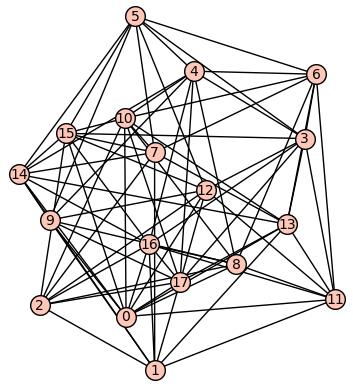

0 0 [8, 9, 10, 11, 12, 13, 14, 15, 16, 17]
G_TklS


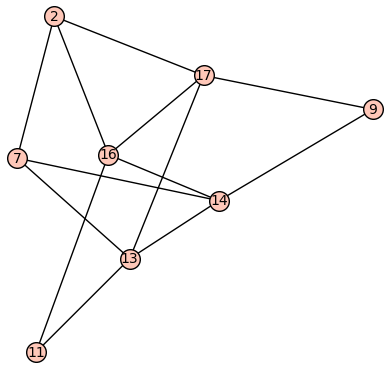

0 1 [2, 7, 9, 11, 13, 14, 16, 17]
Gb@\Ks


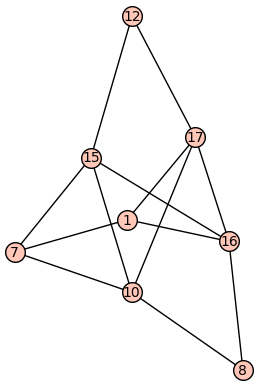

0 2 [1, 7, 8, 10, 12, 15, 16, 17]
0 3 [4, 5, 6, 11, 12, 13, 15, 16, 17]
0 4 [3, 5, 6, 8, 9, 10, 14, 16, 17]
GxQIsk


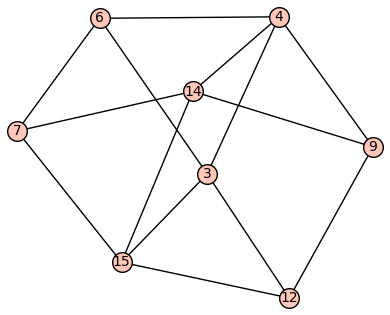

0 5 [3, 4, 6, 7, 9, 12, 14, 15]
GxP[Sk


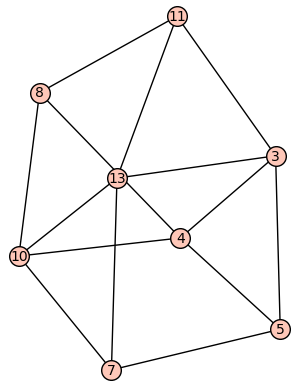

0 6 [3, 4, 5, 7, 8, 10, 11, 13]
G`U\JS


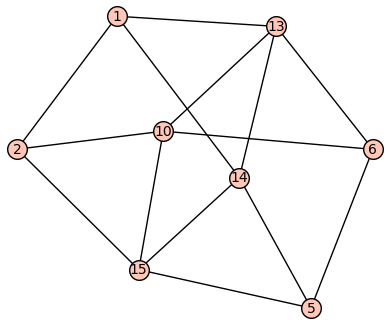

0 7 [1, 2, 5, 6, 10, 13, 14, 15]
G@jsfC


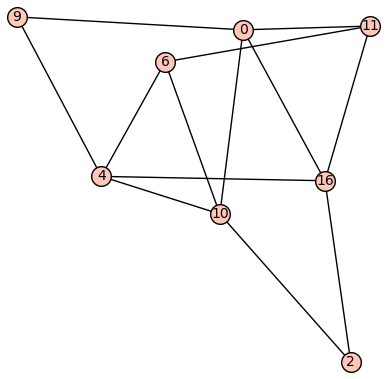

0 8 [0, 2, 4, 6, 9, 10, 11, 16]
G@iVfG


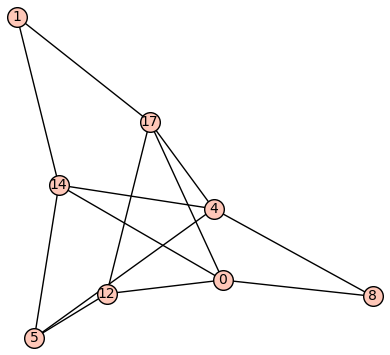

0 9 [0, 1, 4, 5, 8, 12, 14, 17]
0 10 [0, 2, 4, 6, 7, 8, 13, 15, 17]
G@effO


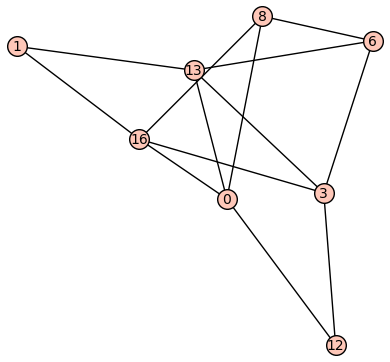

0 11 [0, 1, 3, 6, 8, 12, 13, 16]
G@effO


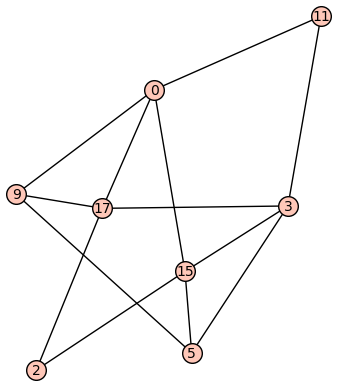

0 12 [0, 2, 3, 5, 9, 11, 15, 17]
0 13 [0, 1, 3, 6, 7, 10, 11, 14, 17]
0 14 [0, 1, 4, 5, 7, 9, 13, 15, 16]
0 15 [0, 2, 3, 5, 7, 10, 12, 14, 16]
0 16 [0, 1, 2, 3, 4, 8, 11, 14, 15, 17]
0 17 [0, 1, 2, 3, 4, 9, 10, 12, 13, 16]


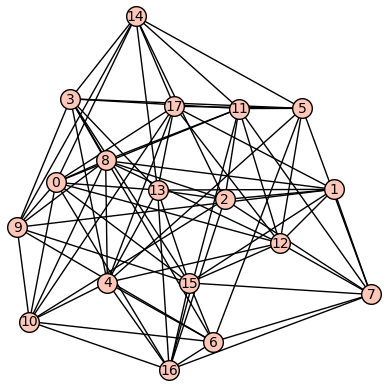

1 0 [8, 9, 10, 11, 12, 13, 14, 15, 16, 17]
GpYAwW


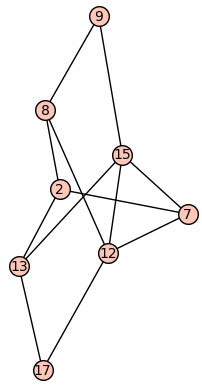

1 1 [2, 7, 8, 9, 12, 13, 15, 17]
GpY?Yw


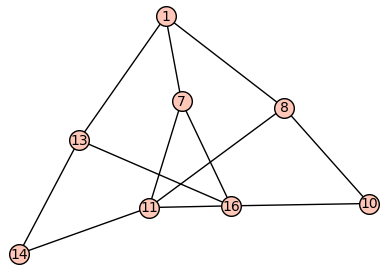

1 2 [1, 7, 8, 10, 11, 13, 14, 16]
1 3 [4, 5, 6, 8, 9, 11, 13, 14, 15]
1 4 [3, 5, 6, 8, 10, 12, 13, 16, 17]
Gxd[QK


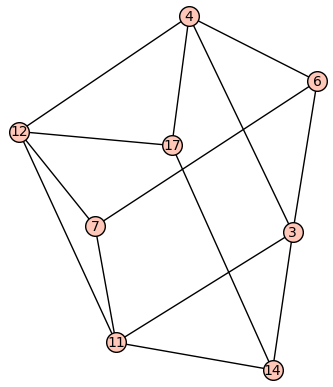

1 5 [3, 4, 6, 7, 11, 12, 14, 17]
Gx`Kqk


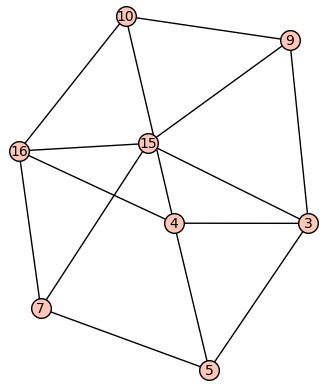

1 6 [3, 4, 5, 7, 9, 10, 15, 16]
G`Ykis


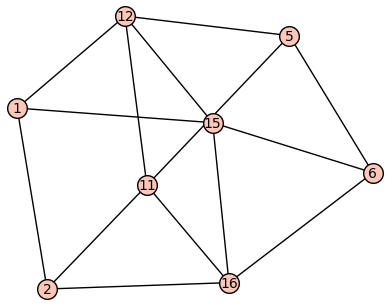

1 7 [1, 2, 5, 6, 11, 12, 15, 16]
1 8 [0, 1, 2, 3, 4, 9, 10, 11, 12]
G@y\F_


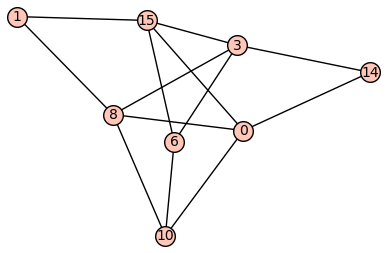

1 9 [0, 1, 3, 6, 8, 10, 14, 15]
G@y^d?


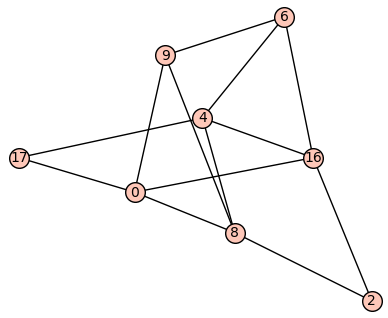

1 10 [0, 2, 4, 6, 8, 9, 16, 17]
1 11 [0, 2, 3, 5, 7, 8, 12, 14, 16]
1 12 [0, 1, 4, 5, 7, 8, 11, 15, 17]
1 13 [0, 1, 2, 3, 4, 14, 15, 16, 17]
G@jvCc


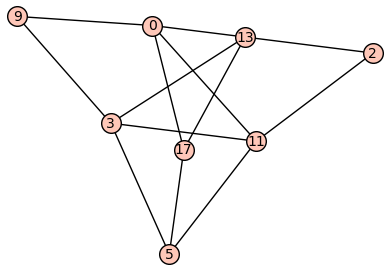

1 14 [0, 2, 3, 5, 9, 11, 13, 17]
1 15 [0, 1, 3, 6, 7, 9, 12, 13, 16]
1 16 [0, 2, 4, 6, 7, 10, 11, 13, 15]
G@jvCc


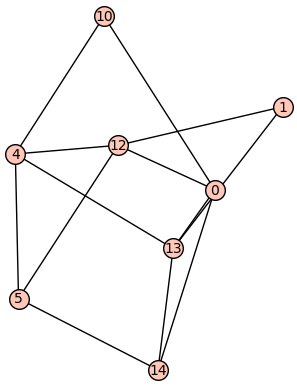

1 17 [0, 1, 4, 5, 10, 12, 13, 14]


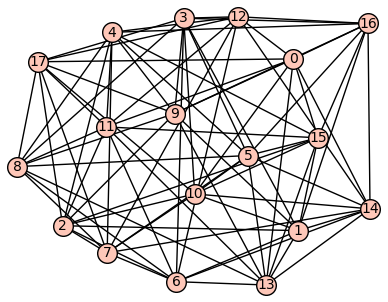

2 0 [9, 10, 11, 12, 13, 14, 15, 16, 17]
2 1 [2, 3, 6, 9, 10, 13, 14, 15, 16]
2 2 [1, 4, 6, 7, 9, 10, 11, 15, 17]
2 3 [1, 5, 6, 8, 9, 10, 12, 16, 17]
2 4 [2, 5, 7, 8, 9, 11, 12, 15, 16]
2 5 [3, 4, 7, 8, 10, 13, 14, 15, 16]
2 6 [1, 2, 3, 7, 8, 11, 12, 13, 14]
2 7 [2, 4, 5, 6, 8, 10, 12, 14, 17]
2 8 [3, 4, 5, 6, 7, 9, 11, 13, 17]
2 9 [0, 1, 2, 3, 4, 8, 13, 16, 17]
2 10 [0, 1, 2, 3, 5, 7, 14, 15, 17]
2 11 [0, 2, 4, 6, 8, 12, 13, 15, 17]
2 12 [0, 3, 4, 6, 7, 11, 14, 16, 17]
2 13 [0, 1, 5, 6, 8, 9, 11, 14, 15]
2 14 [0, 1, 5, 6, 7, 10, 12, 13, 16]
2 15 [0, 1, 2, 4, 5, 10, 11, 13, 16]
2 16 [0, 1, 3, 4, 5, 9, 12, 14, 15]
2 17 [0, 2, 3, 7, 8, 9, 10, 11, 12]


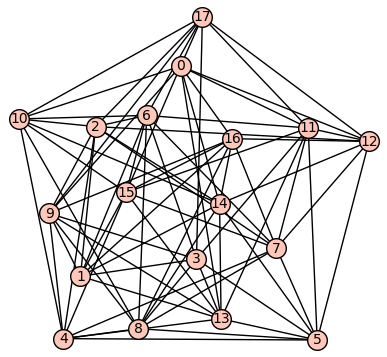

3 0 [9, 10, 11, 12, 13, 14, 15, 16, 17]
G]UHOk


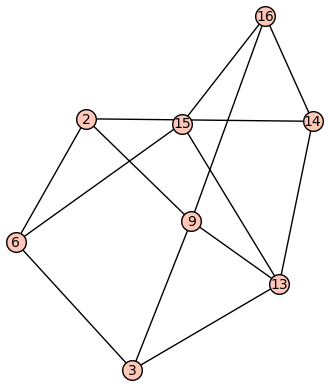

3 1 [2, 3, 6, 9, 13, 14, 15, 16]
3 2 [1, 4, 6, 7, 9, 10, 12, 14, 17]
GRdeXW


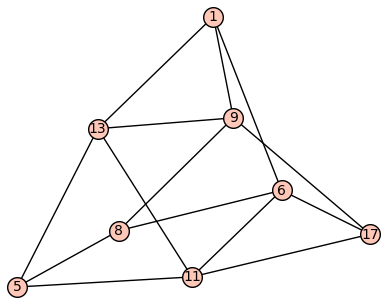

3 3 [1, 5, 6, 8, 9, 11, 13, 17]
GZeQPK


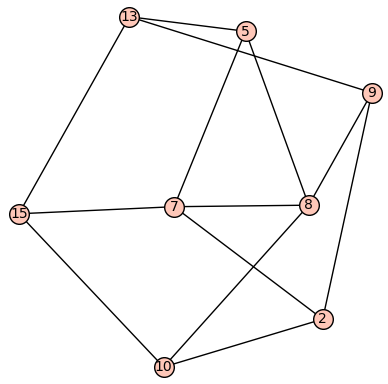

3 4 [2, 5, 7, 8, 9, 10, 13, 15]
GNgmOk


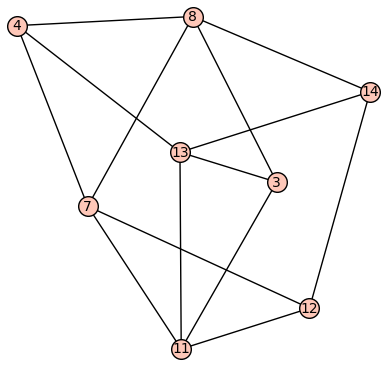

3 5 [3, 4, 7, 8, 11, 12, 13, 14]
3 6 [1, 2, 3, 7, 8, 10, 11, 15, 17]
3 7 [2, 4, 5, 6, 8, 11, 12, 15, 16]
3 8 [3, 4, 5, 6, 7, 9, 10, 14, 16]
3 9 [0, 1, 2, 3, 4, 8, 13, 16, 17]
GINLe_


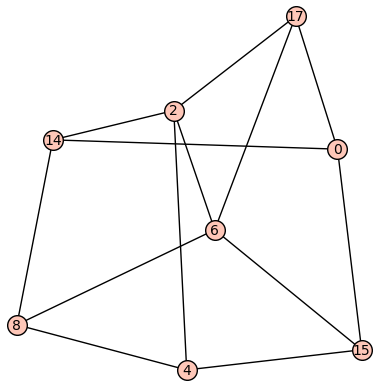

3 10 [0, 2, 4, 6, 8, 14, 15, 17]
3 11 [0, 3, 5, 6, 7, 12, 13, 15, 17]
GBncmO


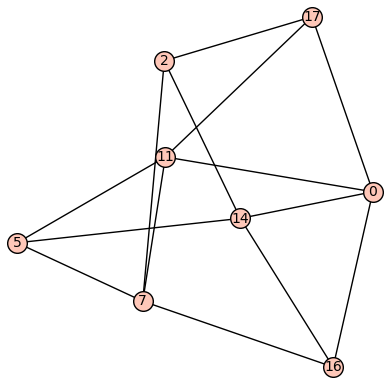

3 12 [0, 2, 5, 7, 11, 14, 16, 17]
3 13 [0, 1, 3, 4, 5, 9, 11, 14, 15]
3 14 [0, 1, 2, 5, 8, 10, 12, 13, 16]
3 15 [0, 1, 4, 6, 7, 10, 11, 13, 16]
G@uen?


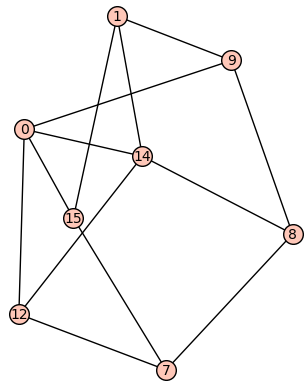

3 16 [0, 1, 7, 8, 9, 12, 14, 15]
GBzTeC


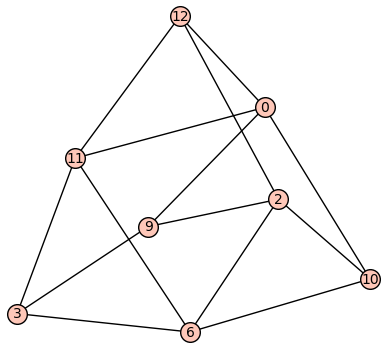

3 17 [0, 2, 3, 6, 9, 10, 11, 12]


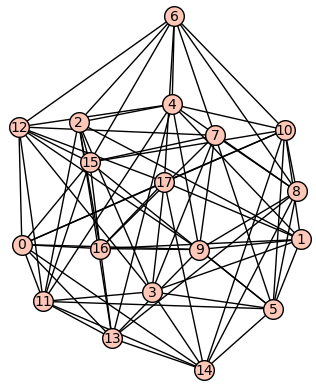

4 0 [9, 10, 11, 12, 13, 14, 15, 16, 17]
GqKsQK


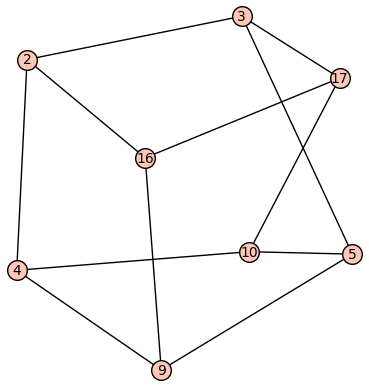

4 1 [2, 3, 4, 5, 9, 10, 16, 17]
GpWgsK


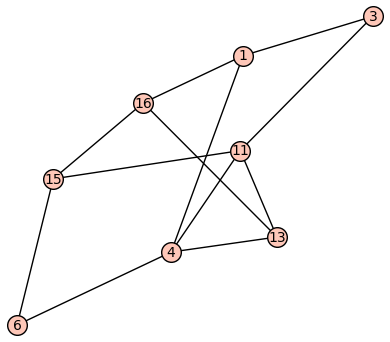

4 2 [1, 3, 4, 6, 11, 13, 15, 16]
GpWXSK


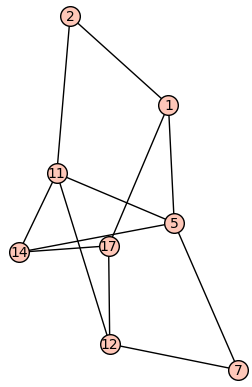

4 3 [1, 2, 5, 7, 11, 12, 14, 17]
4 4 [1, 2, 6, 8, 9, 10, 11, 12, 13]
4 5 [1, 3, 7, 8, 9, 10, 11, 14, 15]
GbTdWW


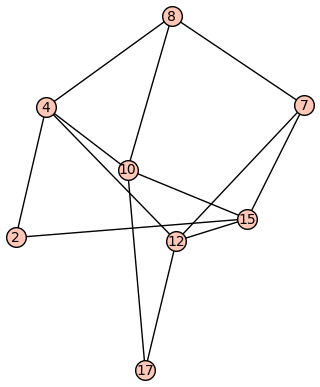

4 6 [2, 4, 7, 8, 10, 12, 15, 17]
GbUjGS


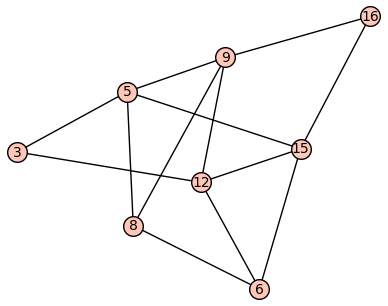

4 7 [3, 5, 6, 8, 9, 12, 15, 16]
GRvcQK


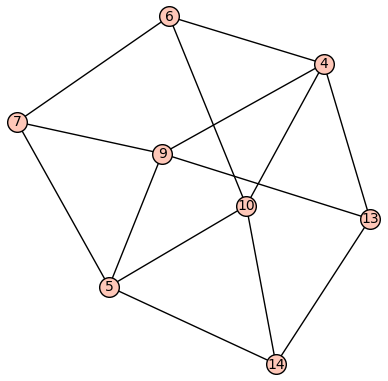

4 8 [4, 5, 6, 7, 9, 10, 13, 14]
4 9 [0, 1, 4, 5, 7, 8, 12, 13, 16]
4 10 [0, 1, 4, 5, 6, 8, 14, 15, 17]
4 11 [0, 2, 3, 4, 5, 12, 13, 14, 15]
4 12 [0, 3, 4, 6, 7, 9, 11, 15, 17]
GHncmO


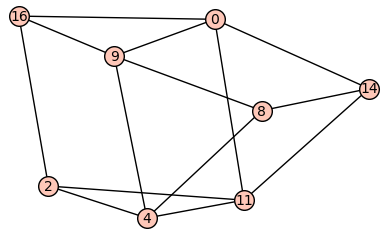

4 13 [0, 2, 4, 8, 9, 11, 14, 16]
GHncmO


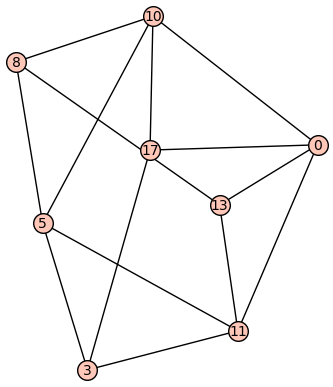

4 14 [0, 3, 5, 8, 10, 11, 13, 17]
4 15 [0, 2, 5, 6, 7, 10, 11, 12, 16]
GGule?


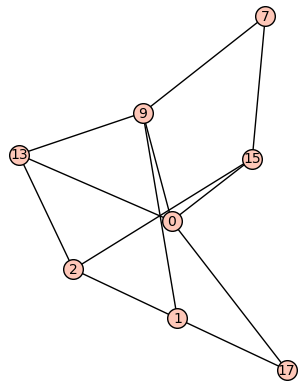

4 16 [0, 1, 2, 7, 9, 13, 15, 17]
GGutU?


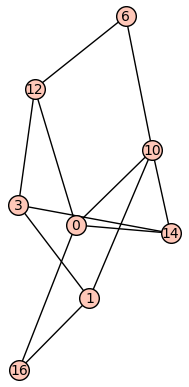

4 17 [0, 1, 3, 6, 10, 12, 14, 16]


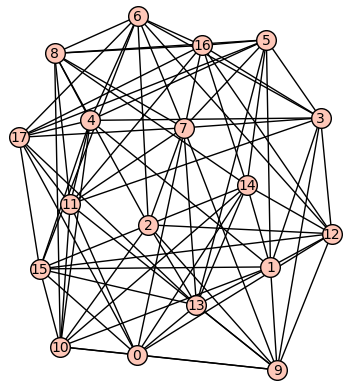

5 0 [9, 10, 11, 12, 13, 14, 15, 16, 17]
5 1 [3, 4, 5, 9, 10, 12, 13, 14, 15]
5 2 [6, 7, 8, 9, 10, 12, 13, 14, 15]
5 3 [1, 4, 5, 6, 7, 9, 11, 12, 16]
5 4 [1, 3, 5, 6, 8, 10, 11, 15, 17]
5 5 [1, 3, 4, 7, 8, 13, 14, 16, 17]
5 6 [2, 3, 4, 7, 8, 12, 15, 16, 17]
5 7 [2, 3, 5, 6, 8, 9, 11, 13, 17]
5 8 [2, 4, 5, 6, 7, 10, 11, 14, 16]
5 9 [0, 1, 2, 3, 7, 10, 11, 12, 13]
5 10 [0, 1, 2, 4, 8, 9, 11, 14, 15]
5 11 [0, 3, 4, 7, 8, 9, 10, 16, 17]
5 12 [0, 1, 2, 3, 6, 9, 14, 15, 16]
5 13 [0, 1, 2, 5, 7, 9, 14, 15, 17]
5 14 [0, 1, 2, 5, 8, 10, 12, 13, 16]
5 15 [0, 1, 2, 4, 6, 10, 12, 13, 17]
5 16 [0, 3, 5, 6, 8, 11, 12, 14, 17]
5 17 [0, 4, 5, 6, 7, 11, 13, 15, 16]


In [34]:
import itertools

pointed_graphs_7_ind = []
pointed_graphs_8_ind = []
pointed_graphs_9_ind = []
pointed_graphs_10_ind = []


from sage.graphs.graph_input import from_graph6
with open('finishedGluings.g6', 'r') as file: # Opens the file, and closes it once we exit this block. 
    graphs = file.readlines() 
    for i in range(len(graphs)):
        G = Graph() # Create an empty graph
        from_graph6(G, graphs[i])
        G = G.complement()
        G.show()
        for vertex in G.vertices():
            possible_K = G.neighbors(vertex)
            if len(possible_K) == 7:
                pointed_graphs_7_ind.append([G.copy(), vertex, possible_K])
                print(i,vertex, possible_K)
            if len(possible_K) == 8:
                pointed_graphs_8_ind.append([G.copy(), vertex, possible_K])
                print(G.subgraph(possible_K).graph6_string())
                G.subgraph(possible_K).show()
                print(i,vertex, possible_K)
            if len(possible_K) == 9:
                pointed_graphs_9_ind.append([G.copy(), vertex, possible_K])
                print(i,vertex, possible_K)
            if len(possible_K) == 10:
                pointed_graphs_10_ind.append([G.copy(), vertex, possible_K])
                print(i,vertex, possible_K)

In [35]:
num_pointed_7 = len(pointed_graphs_7_ind)
num_pointed_8 = len(pointed_graphs_8_ind)
num_pointed_9 = len(pointed_graphs_9_ind)
num_pointed_10 = len(pointed_graphs_10_ind)

print(num_pointed_7)
print(len(pointed_graphs_8_ind))
print(len(pointed_graphs_9_ind))
print(len(pointed_graphs_10_ind))
print(len(pointed_graphs_7_ind + pointed_graphs_8_ind + pointed_graphs_9_ind + pointed_graphs_10_ind))

0
36
68
4
108


Note that in order to get the total number of (non-unique) gluings we would need to count the number of automorphisms of K for each of the pointed graphs.

In [20]:
unique_gluings_7 = []

for i in range(num_pointed_7):
    pointed_graph = pointed_graphs_7_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(7):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(18):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_7):
        other_pointed_graph = pointed_graphs_7_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(7):
                map2[perm[k]] = "k"+str(k)
            for k in range(18):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_7:
                if H.is_isomorphic(gluing):
                    unique = false
                    print("NOT Unique")
            
            if unique:
                unique_gluings_7.append(H)
                print("Unique")

In [5]:
unique_gluings_8 = []

for i in range(num_pointed_8):
    pointed_graph = pointed_graphs_8_ind[i]
    G = pointed_graph[0].copy()
    map1 = {pointed_graph[1]: "a"}
    for j in range(8):
        map1[pointed_graph[2][j]] = "k"+str(j)
    for j in range(18):
        if j not in map1:
            map1[j] = "g"+str(j)
#     print(map1)
    G.relabel(map1)
    
    for j in range(i, num_pointed_8):
        other_pointed_graph = pointed_graphs_8_ind[j]
        
        for perm in itertools.permutations(other_pointed_graph[2]):
        
            H = other_pointed_graph[0].copy()
            map2 = {other_pointed_graph[1]: "b"}
            for k in range(8):
                map2[perm[k]] = "k"+str(k)
            for k in range(18):
                if k not in map2:
                    map2[k] = "h"+str(k)
#             print(map2)
            H.relabel(map2)
    
            H.add_edges(G.edge_iterator())
        
            unique = true
            for gluing in unique_gluings_8:
                if H.is_isomorphic(gluing):
                    unique = false
                    break
            
            if unique:
                unique_gluings_8.append(H)
                print("Unique")
            else:
                print("NOT Unique")

Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Uni

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Un

NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique

Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
Unique
NOT Unique
Unique
Unique
Unique
Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Unique
NOT Un

KeyboardInterrupt: 

In [ ]:
len(unique_gluings_8)